In [1]:
# the code for this section is from https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

In [2]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from torch.utils.data import DataLoader, random_split
import torchvision.transforms as transforms
from torchvision import datasets
import torchvision.transforms as transforms


# Set random seed for reproducibility
manualSeed = 999
# manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


In [3]:
import torch
torch.cuda.empty_cache()

In [4]:

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 200

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [5]:
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    
])
print(transform)

Compose(
    Resize(size=64, interpolation=bilinear, max_size=None, antialias=True)
    CenterCrop(size=(64, 64))
    ToTensor()
    Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
)


In [6]:

train_dataset = datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
val_dataset = datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)

# Function to split the dataset
train_loader = DataLoader(dataset=train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(dataset=val_dataset, batch_size=32, shuffle=False)



# print the size of the datasets
print(f"Train size: {len(train_loader.dataset)}")
print(f"Validation size: {len(val_loader.dataset)}")
# print the shape of images after transformation
for images, labels in train_loader:
    print(f"Shape of batch of images after transformation: {images.shape}")
    break


Files already downloaded and verified
Files already downloaded and verified
Train size: 50000
Validation size: 10000
Shape of batch of images after transformation: torch.Size([32, 3, 64, 64])


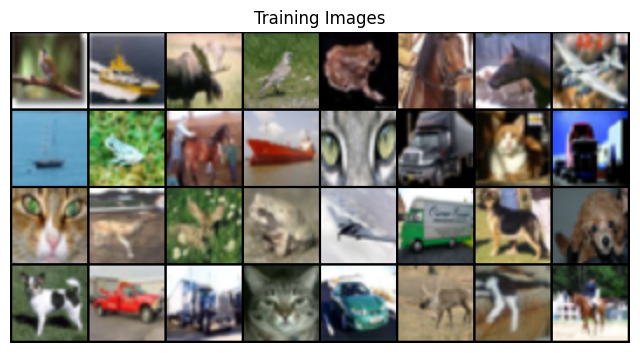

In [7]:
# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()


In [8]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [9]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [10]:
# Create the generator
netG = Generator(ngpu).to(device)


# Apply the ``weights_init`` function to randomly initialize all weights to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [11]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [12]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)


# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [13]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [14]:
from skimage.metrics import structural_similarity as ssim
import torch.nn.functional as F
import cv2
# compute the mean squared error and the ssim score
def compute_mse(x, recon_x):
    x = F.relu(x)
    mse_loss = F.mse_loss(x, recon_x, reduction='sum')
    return mse_loss




def compute_ssim(x, recon_x):
    # Permute to (batch, height, width, channels) for SSIM
    x = x.permute(0, 2, 3, 1).detach().cpu().numpy()
    recon_x = recon_x.permute(0, 2, 3, 1).detach().cpu().numpy()
    
    # Calculate SSIM without converting to grayscale again
    ssim_scores = []
    for i in range(x.shape[0]):
        # print the shape of the images
        
        score = ssim(x[i], recon_x[i],win_size=11, channel_axis=-1,data_range=1)
        ssim_scores.append(score)
    
    # Print average SSIM score for the batch
    avg_ssim = sum(ssim_scores) / len(ssim_scores)
    
    return 1 - avg_ssim  # Return SSIM loss



In [15]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
Epoch_G_losses = []
Epoch_D_losses = []

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    epoch_g_loss = 0.0
    epoch_d_loss = 0.0
    num_batches = 0

    for i, data in enumerate(train_loader, 0):
        num_batches += 1

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
        epoch_g_loss += errG.item()
        epoch_d_loss += errD.item()


        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(train_loader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(train_loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
    epoch_g_loss /= num_batches
    epoch_d_loss /= num_batches
    Epoch_G_losses.append(epoch_g_loss)
    Epoch_D_losses.append(epoch_d_loss)
    print(f"Epoch {epoch} completed. G Loss: {epoch_g_loss}, D Loss: {epoch_d_loss}")
    

Starting Training Loop...
[0/200][0/1563]	Loss_D: 1.9828	Loss_G: 6.3717	D(x): 0.5330	D(G(z)): 0.6609 / 0.0025
[0/200][50/1563]	Loss_D: 0.2651	Loss_G: 7.5737	D(x): 0.9412	D(G(z)): 0.1379 / 0.0010
[0/200][100/1563]	Loss_D: 0.3477	Loss_G: 5.6399	D(x): 0.8039	D(G(z)): 0.0318 / 0.0065
[0/200][150/1563]	Loss_D: 0.3891	Loss_G: 5.0441	D(x): 0.9717	D(G(z)): 0.2797 / 0.0172
[0/200][200/1563]	Loss_D: 0.4815	Loss_G: 8.1390	D(x): 0.9142	D(G(z)): 0.2982 / 0.0005
[0/200][250/1563]	Loss_D: 0.3126	Loss_G: 8.0836	D(x): 0.9125	D(G(z)): 0.1383 / 0.0006
[0/200][300/1563]	Loss_D: 0.0447	Loss_G: 7.2082	D(x): 0.9603	D(G(z)): 0.0010 / 0.0017
[0/200][350/1563]	Loss_D: 0.4266	Loss_G: 4.6139	D(x): 0.7598	D(G(z)): 0.0385 / 0.0218
[0/200][400/1563]	Loss_D: 0.2534	Loss_G: 5.1763	D(x): 0.9905	D(G(z)): 0.1658 / 0.0124
[0/200][450/1563]	Loss_D: 1.0791	Loss_G: 9.2093	D(x): 0.9014	D(G(z)): 0.5230 / 0.0003
[0/200][500/1563]	Loss_D: 0.4771	Loss_G: 5.1719	D(x): 0.9697	D(G(z)): 0.2653 / 0.0136
[0/200][550/1563]	Loss_D: 0.332

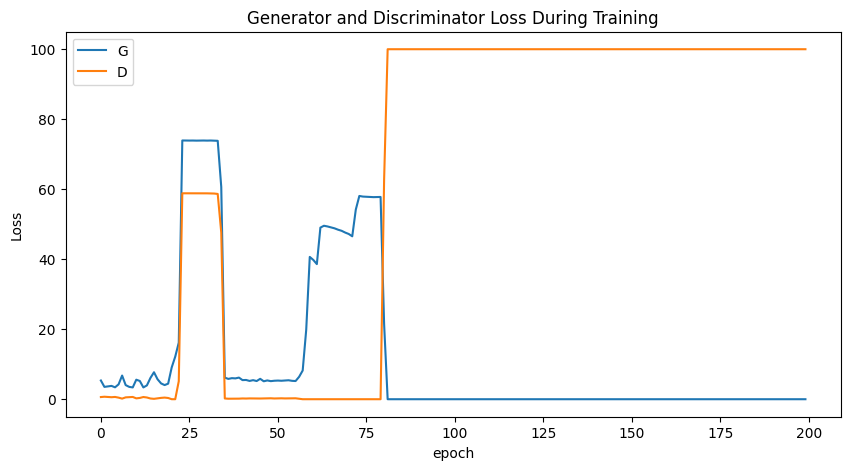

In [16]:
# plot the average loss for each epoch
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(Epoch_G_losses,label="G")
plt.plot(Epoch_D_losses,label="D")
plt.xlabel("epoch")
plt.ylabel("Loss")
plt.legend()
plt.show()



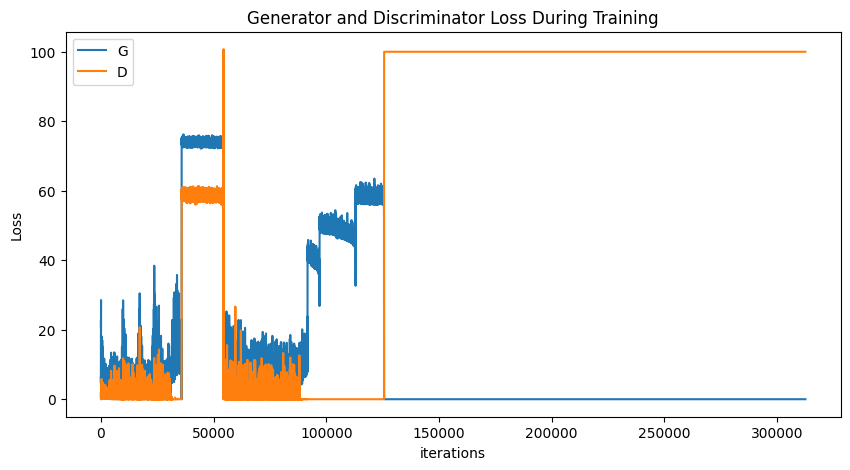

In [17]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


In [18]:
# plt.figure(figsize=(10,5))
# plt.title("MSE Loss During Training and Validation")
# plt.plot(MSE_losses, label="Train MSE")
# plt.plot(test_MSE_losses, label="Test MSE")
# plt.xlabel("epochs")
# plt.ylabel("MSE Loss")
# plt.legend()
# plt.show()


In [19]:
# plt.figure(figsize=(10,5))
# plt.title("SSIM Loss During Training and Validation")
# plt.plot(SSIM_losses, label="Train SSIM")
# plt.plot(test_SSIM_losses, label="Test SSIM")
# plt.xlabel("epochs")
# plt.ylabel("SSIM")
# plt.legend()
# plt.show()


Animation size has reached 21225993 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


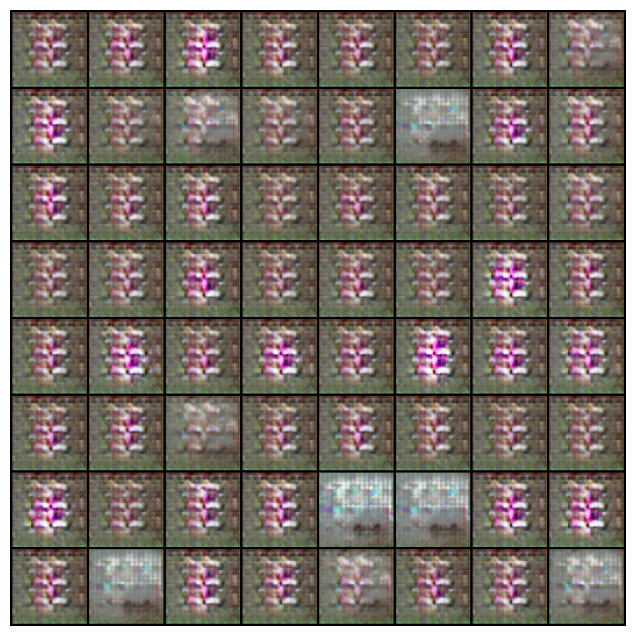

In [20]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())


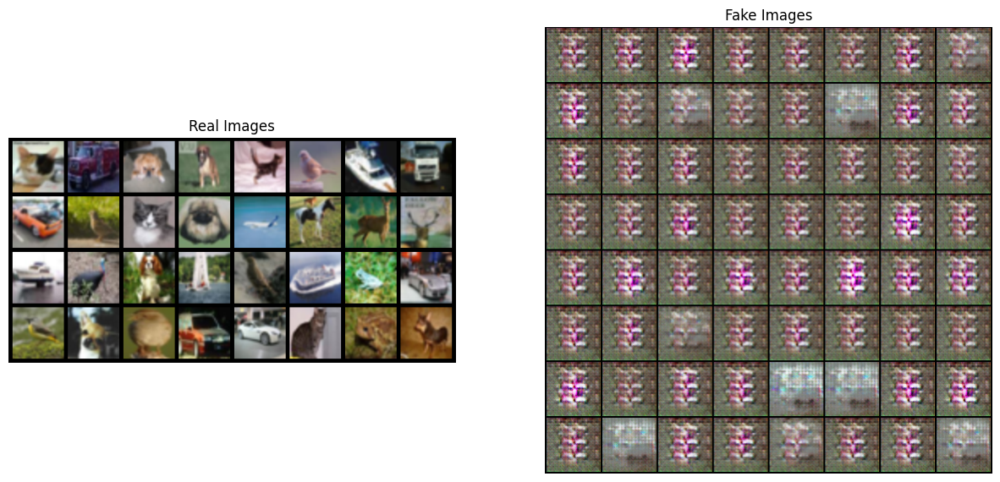

In [21]:
real_batch = next(iter(train_loader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()


In [22]:
# test the model on the validation set
netG.eval()
test_MSE_losses = []
test_SSIM_losses = []

for i, data in enumerate(val_loader, 0):
    real_cpu = data[0].to(device)
    b_size = real_cpu.size(0)
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    fake = netG(noise)
    mse_loss = compute_mse(real_cpu, fake)
    ssim_loss = compute_ssim(real_cpu, fake)
    test_MSE_losses.append(mse_loss.item())
    test_SSIM_losses.append(ssim_loss)

print(f"Average MSE Loss on Test Set: {sum(test_MSE_losses) / len(test_MSE_losses)}")
print(f"Average SSIM Loss on Test Set: {sum(test_SSIM_losses) / len(test_SSIM_losses)}")

Average MSE Loss on Test Set: 109519.06412240415
Average SSIM Loss on Test Set: 0.995226709497851
